In [7]:
import cv2
import json
import numpy as np
from PIL import Image
from IPython.display import display, HTML

# Hackathon - Photo Measurements

- Measurements of historical items is inconsistent and cannot be easily corrected retroactively.
    - Measurements definitions and rules are open to interpretation.
    - Some items are too amorphous too easily measure

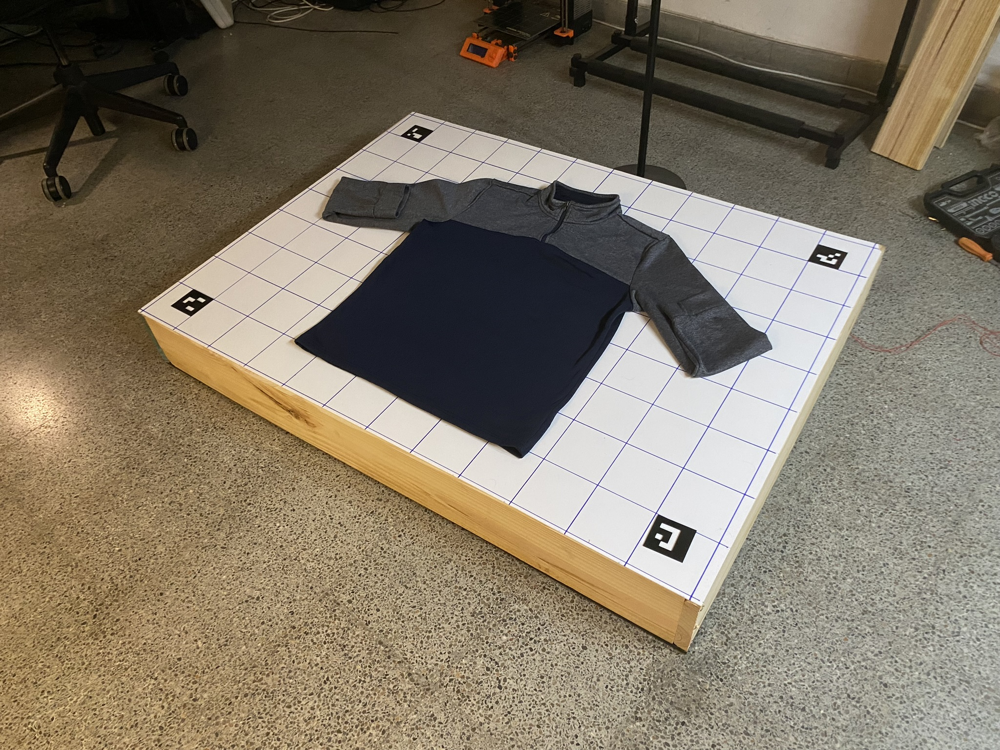

In [15]:
image = cv2.imread("./project_photos/enclosure-finished-off.JPEG")
display(Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)))

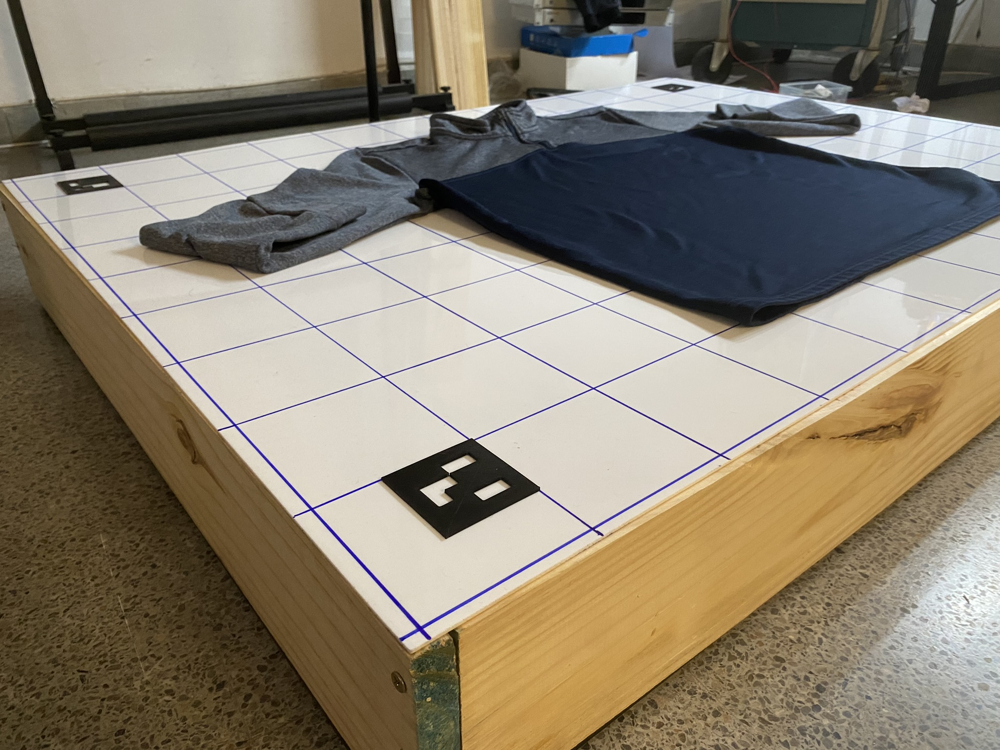

In [18]:
image = cv2.imread("./project_photos/fiducial.JPEG")
display(Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)))

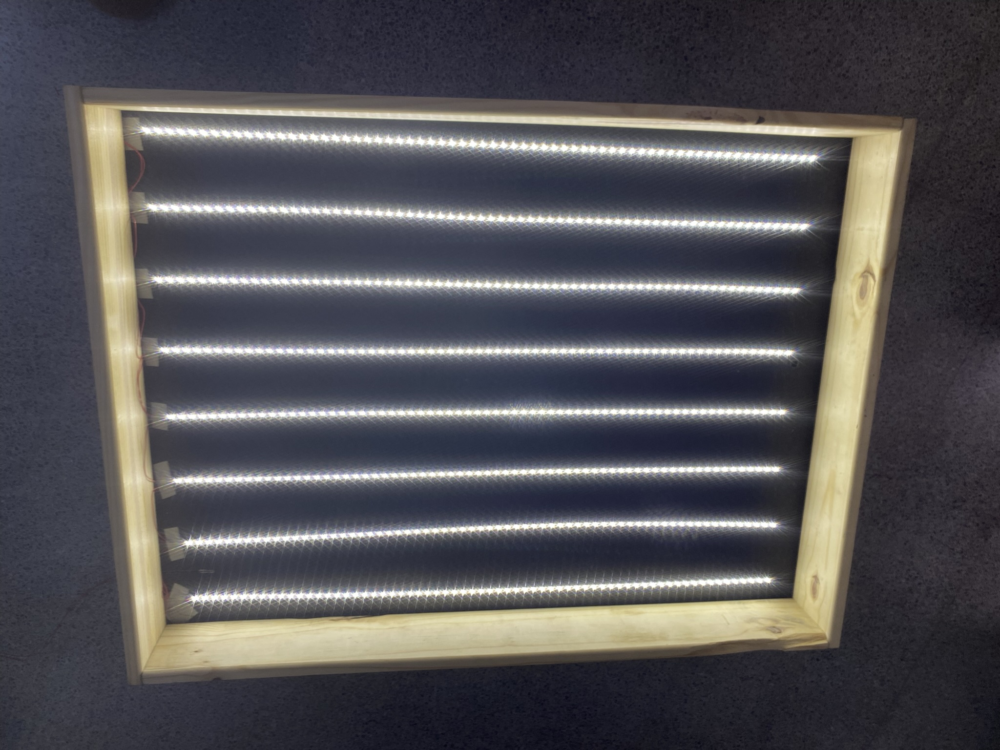

In [14]:
image = cv2.imread("./project_photos/enclosure-leds-on.JPEG")
display(Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)))

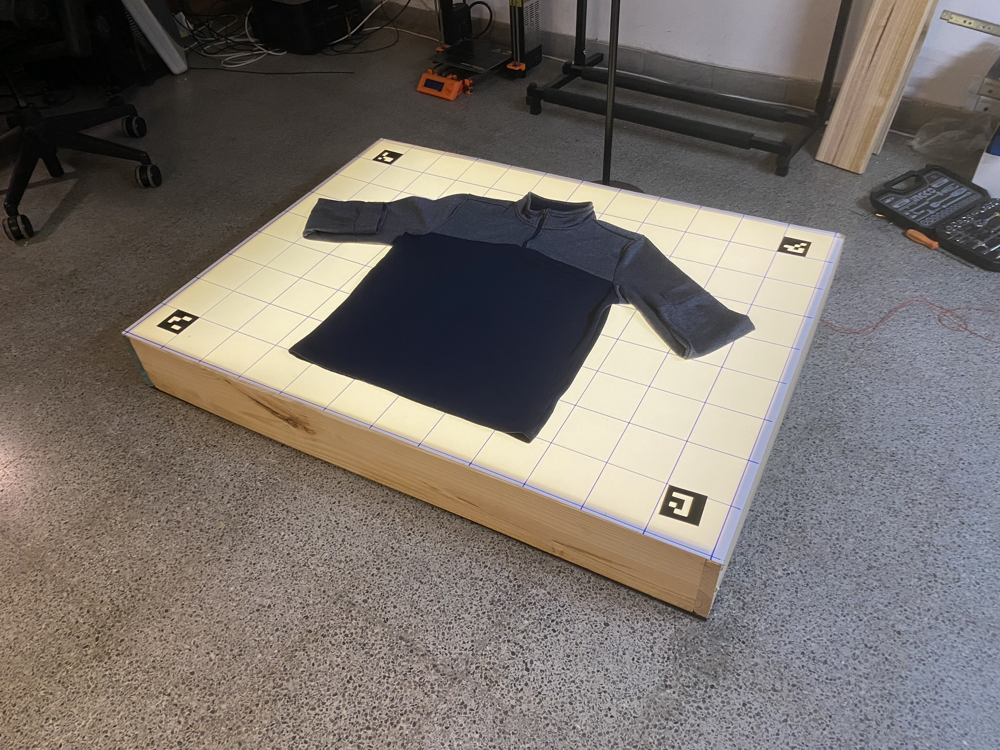

In [16]:
image = cv2.imread("./project_photos/enclosure-finished-on.JPEG")
display(Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)))

# Inputs

In [19]:
known_distance_mm = 800  # Known real-life distance between outer edges of first and second fiducials
detail_image_path = './project_photos/real-detail.jpeg'
silhouette_image_path = './project_photos/real-silhouette.jpeg'

# First correct perpsective of silhouette image and align

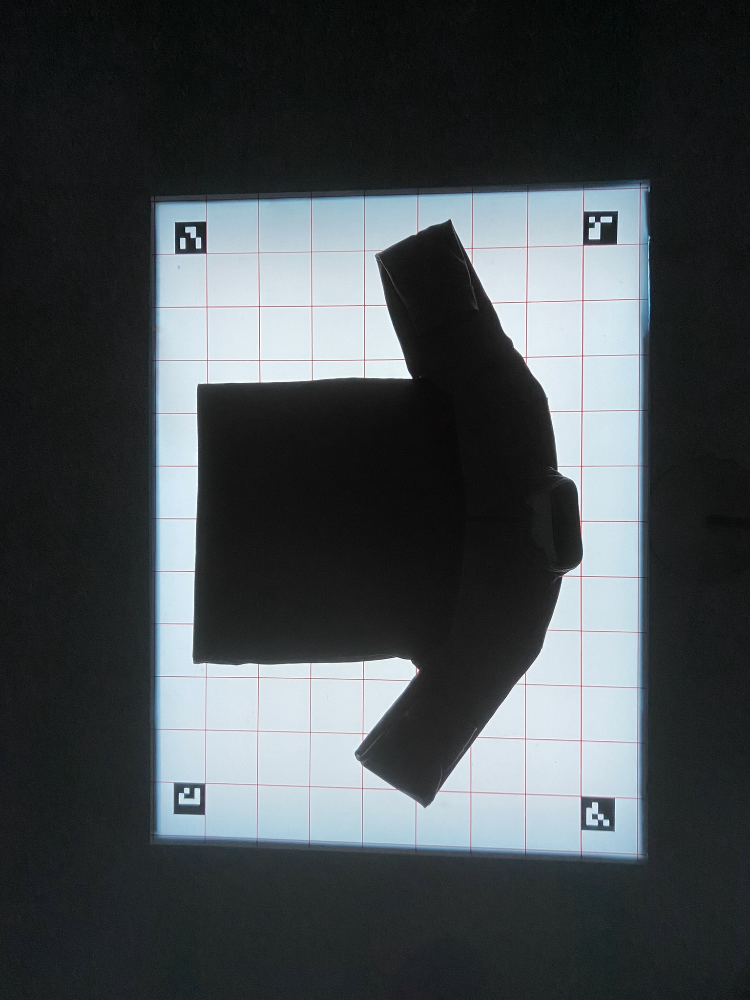

Detected fiducials: [[2], [0], [3], [1]]


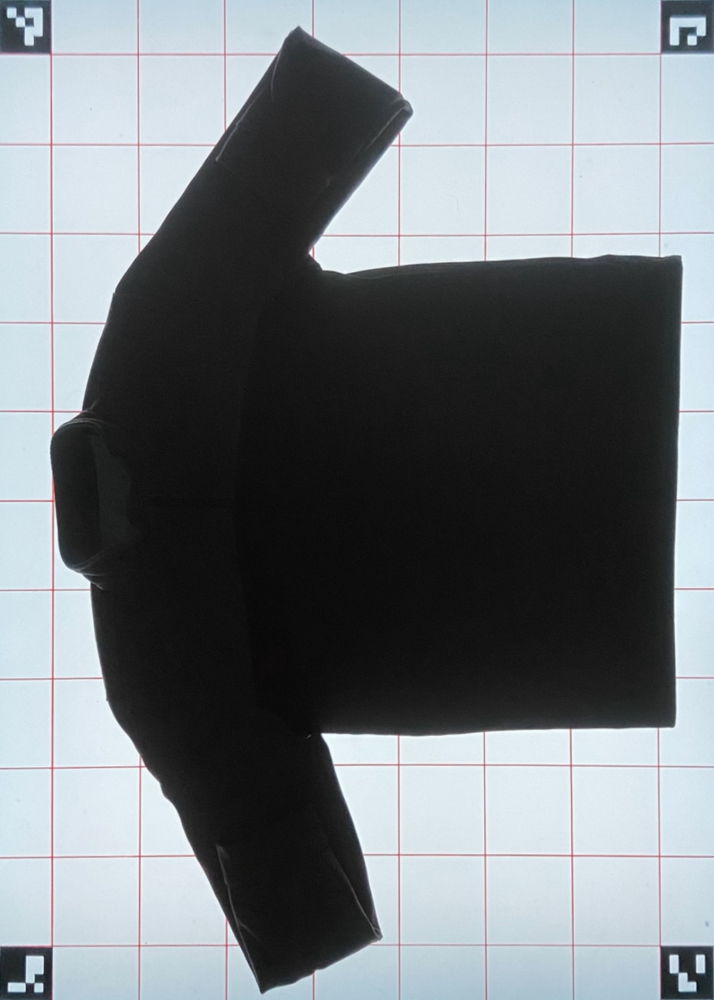

Millimeters per pixel: 0.80


In [20]:
# Load the image
image = cv2.imread(silhouette_image_path)

display(Image.fromarray(image))

# Convert image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

_, thresholded_image = cv2.threshold(gray,127,255,cv2.THRESH_BINARY)

# Load the dictionary that was used to generate the markers.
aruco_dict = cv2.aruco.getPredefinedDictionary(cv2.aruco.DICT_4X4_50)
parameters = cv2.aruco.DetectorParameters()

# Detect the markers in the image
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(thresholded_image, aruco_dict, parameters=parameters)

print("Detected fiducials:", ids.tolist())

if ids is not None:
    # Sort the detected markers by their IDs
    sorted_indices = np.argsort(ids.flatten())
    corners = [corners[i] for i in sorted_indices]

    # Create an array of the marker corners in the order TL, TR, BL, BR
    src_points = np.array([corners[0][0][0],  # top-left
                           corners[1][0][1],  # top-right
                           corners[2][0][3],  # bottom-left
                           corners[3][0][2]], # bottom-right
                          dtype="float32")

    # Assume the desired output size
    width = 1000
    height = 1400

    # The destination points are the corners of a rectangle
    dst_points = np.array([[0, 0],
                           [width - 1, 0],
                           [0, height - 1],
                           [width - 1, height - 1]], dtype="float32")

    # Compute the perspective transform matrix
    matrix = cv2.getPerspectiveTransform(src_points, dst_points)

    # Apply the perspective transformation
    warped = cv2.warpPerspective(image, matrix, (width, height))

    display(Image.fromarray(warped))

    # Calculate the distance between the fiducials in the warped image
    fiducial1 = dst_points[0]  # top-left corner in the warped image
    fiducial2 = dst_points[1]  # top-right corner in the warped image
    pixel_distance = np.linalg.norm(fiducial1 - fiducial2)

    # Calculate millimeters per pixel
    mm_per_pixel = known_distance_mm / pixel_distance

    print(f"Millimeters per pixel: {mm_per_pixel:.2f}")

    with open('calibration.json', 'w') as json_file:
        json.dump(float(mm_per_pixel), json_file)


else:
    print("No ArUco markers found in the image.")


# Get mask of item from perspective-corrected silhouette image

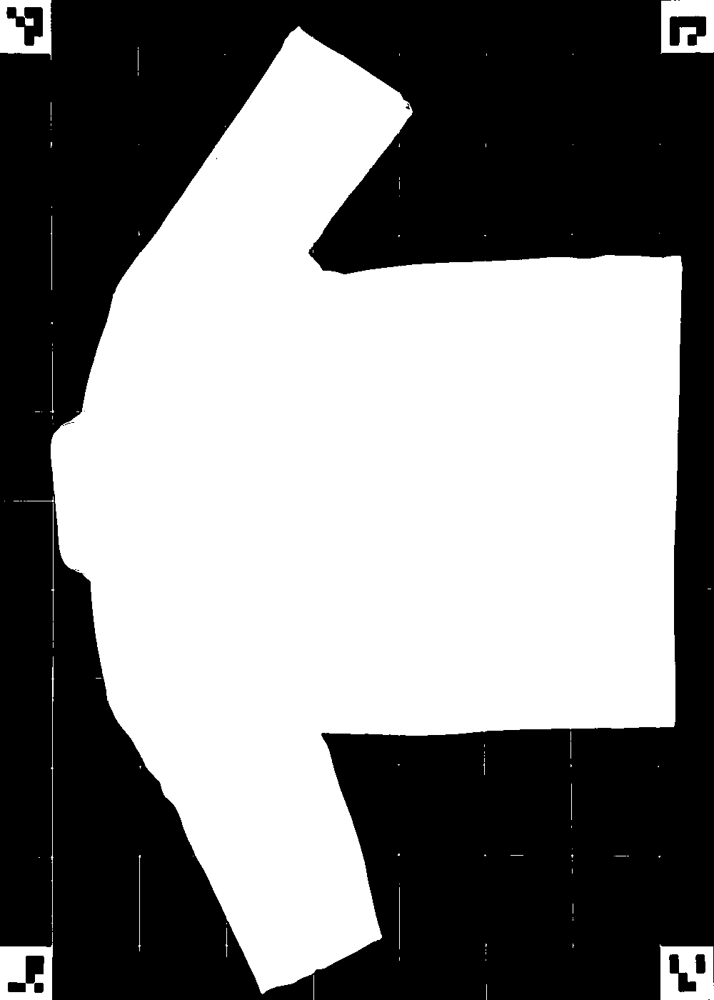

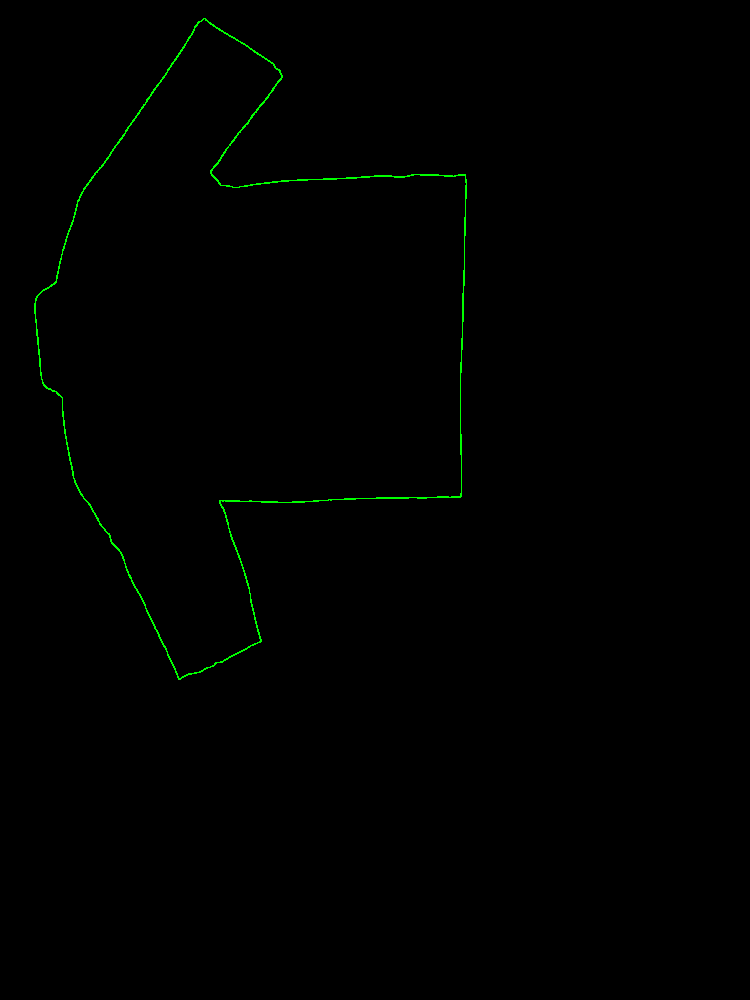

In [4]:
gray = cv2.cvtColor(warped, cv2.COLOR_BGR2GRAY)
_, binary = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY_INV)
display(Image.fromarray(binary))
contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
if contours:
    largest_contour = max(contours, key=cv2.contourArea)

    # Optional: Draw the contour on a blank image
    contour_image = np.zeros_like(image)
    cv2.drawContours(contour_image, [largest_contour], -1, (0, 255, 0), 2)

    # Display the result
    display(Image.fromarray(contour_image))

    # If you need the closed 2D shape as a list of points
    shape_points = largest_contour.reshape(-1, 2).tolist()

    
    # Create a mask from the largest contour
    mask = np.zeros_like(gray)
    cv2.drawContours(mask, [largest_contour], -1, 255, thickness=cv2.FILLED)

    # Convert the mask to a 3-channel mask
    mask_3channel = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)


    lines = []
    for i in range(len(shape_points)):
        start_point = shape_points[i]
        end_point = shape_points[(i + 1) % len(shape_points)]  # Wrap around to the first point to close the shape
        lines.append({
            "start": { "x": start_point[0], "y": start_point[1] },
            "end": { "x": end_point[0], "y": end_point[1] }
        })

    height, width = binary.shape[:2]
    boundary_lines = [
        { "start": { "x": 0, "y": 0 }, "end": { "x": width, "y": 0 } },        # Top boundary
        { "start": { "x": width, "y": 0 }, "end": { "x": width, "y": height } }, # Right boundary
        { "start": { "x": width, "y": height }, "end": { "x": 0, "y": height } }, # Bottom boundary
        { "start": { "x": 0, "y": height }, "end": { "x": 0, "y": 0 } }         # Left boundary
    ]

    lines.extend(boundary_lines)
    
    with open('silhouette.json', 'w') as json_file:
        json.dump(lines, json_file, indent=4)
        

# Then correct perspective of detail image

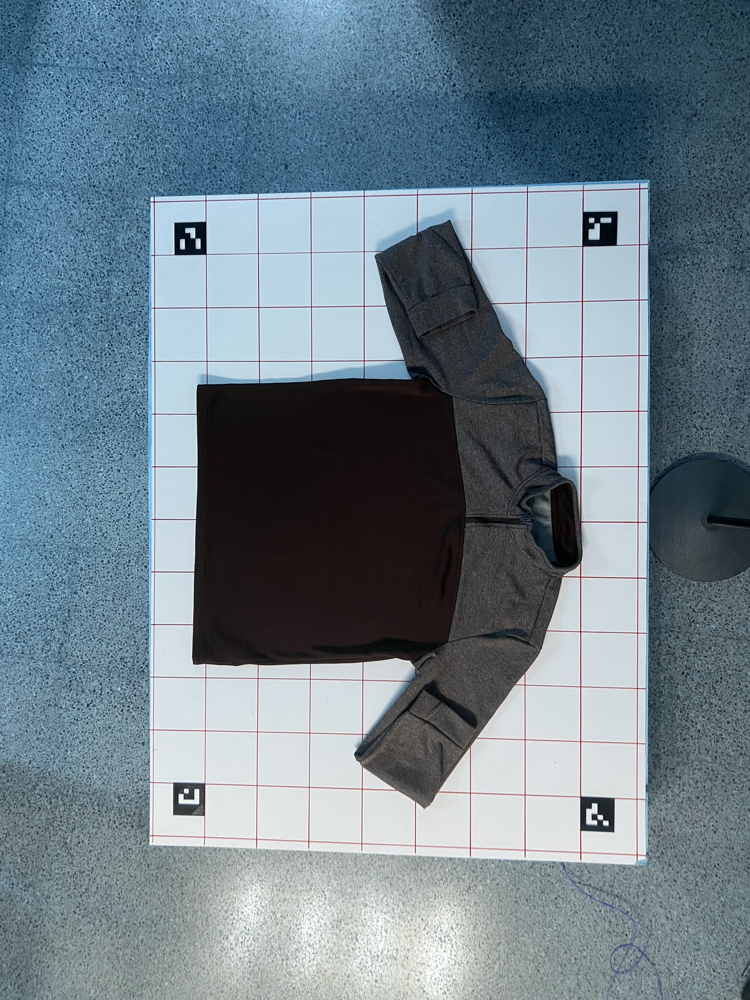

Detected fiducials: [[0], [3], [1], [2]]


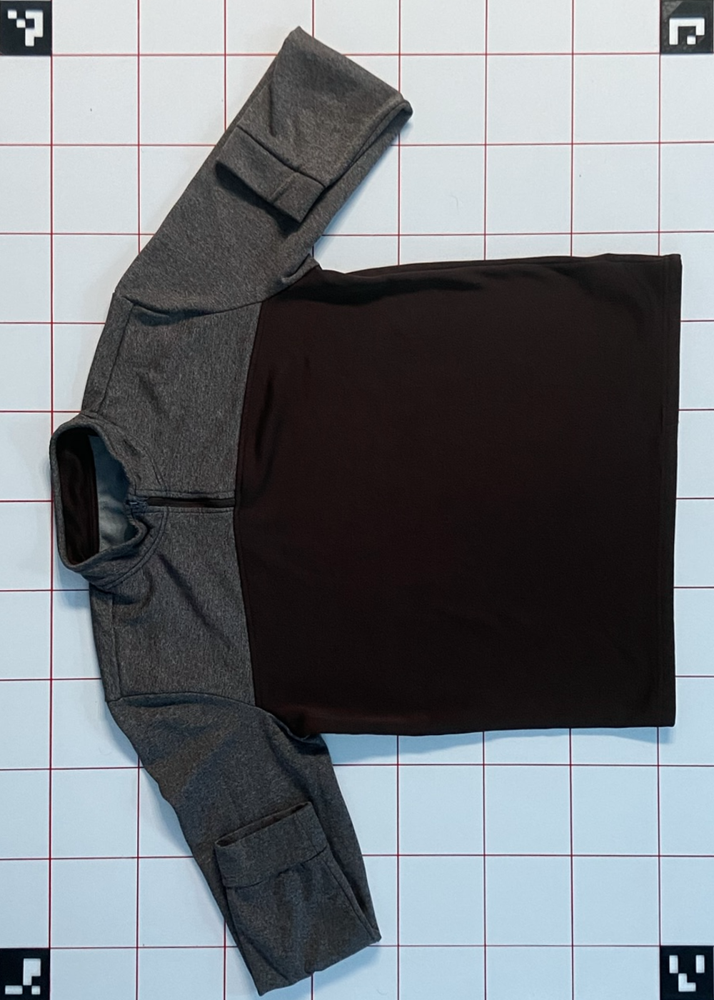

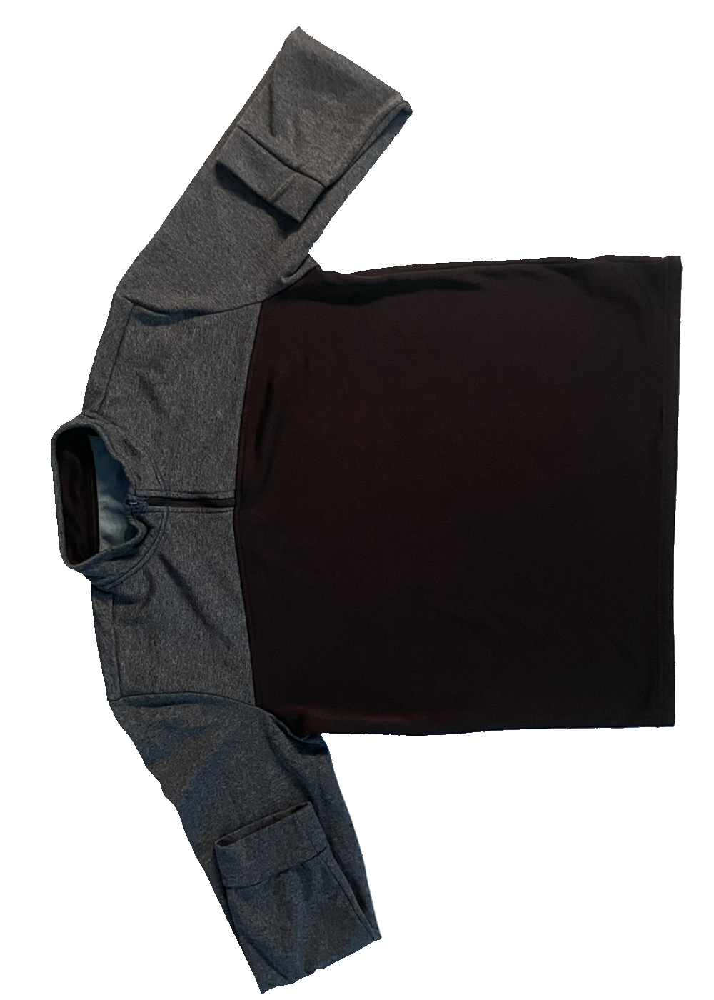

In [6]:
# Load the image
image = cv2.imread(detail_image_path)

display(Image.fromarray(image))

# Convert image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

_, thresholded_image = cv2.threshold(gray,160,255,cv2.THRESH_BINARY)

# Load the dictionary that was used to generate the markers.
aruco_dict = cv2.aruco.getPredefinedDictionary(cv2.aruco.DICT_4X4_50)
parameters = cv2.aruco.DetectorParameters()

# Detect the markers in the image
corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(thresholded_image, aruco_dict, parameters=parameters)

print("Detected fiducials:", ids.tolist())

if ids is not None:
    # Sort the detected markers by their IDs
    sorted_indices = np.argsort(ids.flatten())
    corners = [corners[i] for i in sorted_indices]

    # Create an array of the marker corners in the order TL, TR, BL, BR
    src_points = np.array([corners[0][0][0],  # top-left
                           corners[1][0][1],  # top-right
                           corners[2][0][3],  # bottom-left
                           corners[3][0][2]], # bottom-right
                          dtype="float32")

    # Assume the desired output size
    width = 1000
    height = 1400

    # The destination points are the corners of a rectangle
    dst_points = np.array([[0, 0],
                           [width - 1, 0],
                           [0, height - 1],
                           [width - 1, height - 1]], dtype="float32")

    # Compute the perspective transform matrix
    matrix = cv2.getPerspectiveTransform(src_points, dst_points)

    # Apply the perspective transformation
    warped = cv2.warpPerspective(image, matrix, (width, height))

    # Apply the mask to the original image to isolate the object
    isolated_object = cv2.bitwise_and(warped, mask_3channel)

    # Create a white background image
    white_background = np.ones_like(warped) * 255

    # Combine the isolated object with the white background
    masked_image = np.where(mask_3channel == 0, white_background, isolated_object)

    # Save the masked image if needed
    cv2.imwrite('image.png', masked_image)
    
    display(Image.fromarray(warped))
    display(Image.fromarray(masked_image))

else:
    print("No ArUco markers found in the image.")


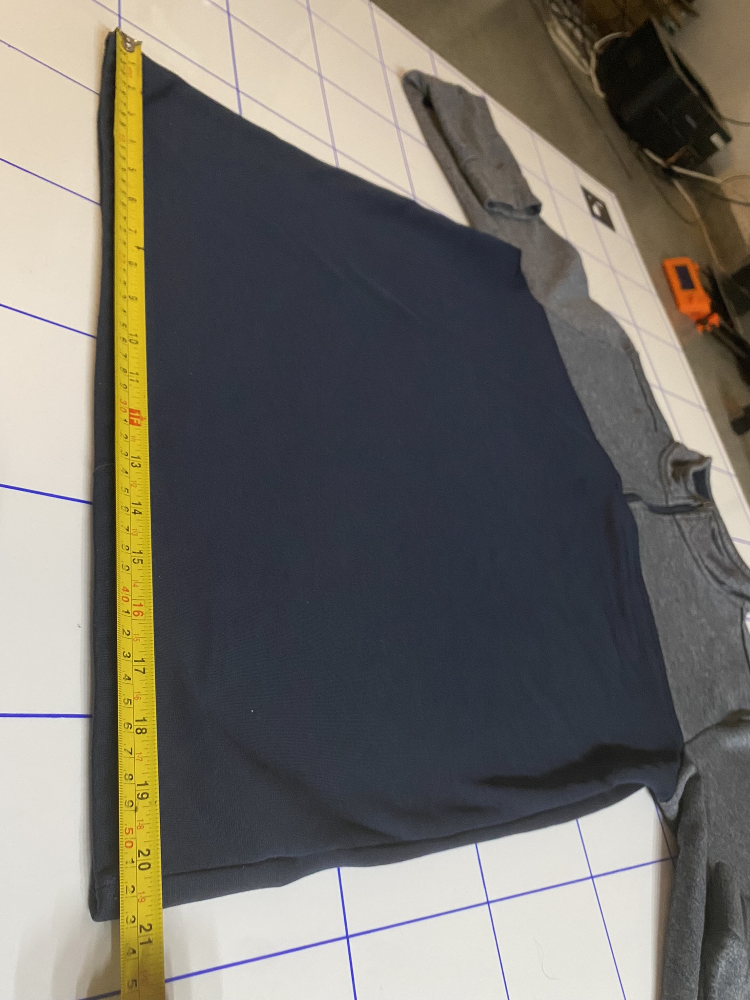

In [17]:
image = cv2.imread("./project_photos/measurement.JPEG")
display(Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)))

# WIP: Lens distortion correction

In [76]:
def find_intersections(lines, img_shape):
    """ Find intersection points of the given lines. """
    intersections = []
    height, width = img_shape
    for i, line1 in enumerate(lines):
        for line2 in lines[i+1:]:
            rho1, theta1 = line1[0]
            rho2, theta2 = line2[0]
            
            A = np.array([
                [np.cos(theta1), np.sin(theta1)],
                [np.cos(theta2), np.sin(theta2)]
            ])
            b = np.array([[rho1], [rho2]])
            
            det = np.linalg.det(A)
            if np.abs(det) > 1e-10:  # Check if lines are not parallel
                x0, y0 = np.linalg.solve(A, b)
                x0, y0 = int(np.round(x0)), int(np.round(y0))
                
                # Check if the intersection point is within the image bounds
                if 0 <= x0 < width and 0 <= y0 < height:
                    intersections.append((x0, y0))
    return intersections


/tmp/ipykernel_5101/706912986.py:66: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x0, y0 = int(np.round(x0)), int(np.round(y0))


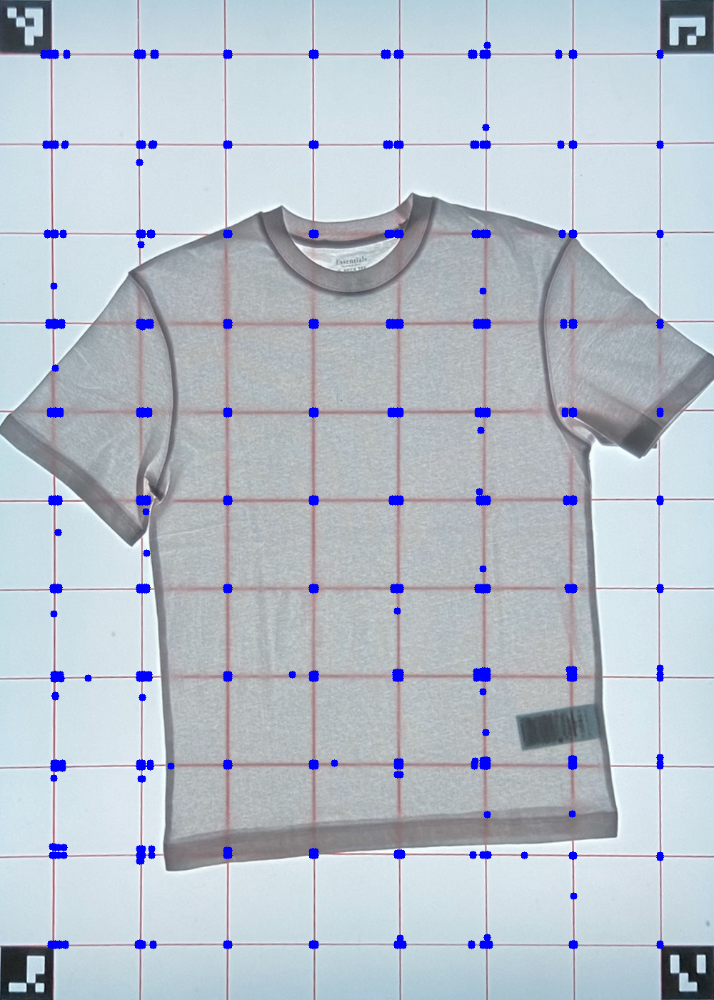

In [91]:
# Edge detection
edges = cv2.Canny(warped, 50, 150, apertureSize=3)

# Detect lines using Hough Line Transform
lines = cv2.HoughLines(edges, 1, np.pi / 180, 200)

# Check if lines were detected
if lines is not None:
    # Find intersection points
    intersections = find_intersections(lines, warped.shape[:2])

    # Draw the intersection points on the original image
    for i, point in enumerate(intersections):
        # Debug statement to show the point
        #print(f"Intersection point: {point}")

        # Ensure the point is an integer tuple
        if isinstance(point, tuple) and len(point) == 2:
            point = (int(point[0]), int(point[1]))
            #print("circle", i, point)
            cv2.circle(warped, point, 5, (0, 0, 255), -1)
        else:
            print(f"Invalid point format: {point}")

display(Image.fromarray(warped))